In [1]:
%matplotlib inline
import os
import numpy as np
import cv2
from matplotlib import pyplot as plt
from util.preprocessing_util import preprocess
from util.visualization_util import show,drawMatches
from util.matching_util     import orb_matching
from util.metrics_util       import rmsd,correlation

In [2]:
def find_registration(ref_filename,reg_filename,out_filename=None,transform='homography',vizualisation=False):
    im1 = cv2.imread(ref_filename,-1)
    im2 = cv2.imread(reg_filename,-1)


    if im1.dtype == 'uint16':
        im1 = preprocess(im1,equalize=True)
    if im2.dtype =='uint16':
        im2 = preprocess(im2,equalize=True)
    
    # keypoints method
    kp1, des1, kp2, des2, matches, T = orb_matching(im1,im2,transform=transform)
    
    if vizualisation == True:
        print('Transformation matrix:')
        print(T)

        # Draw keypoints & matches
        show(drawMatches(im1,kp1,im2,kp2,matches[:20],equalize=True),width=1600)
        im1 = preprocess(im1, equalize=True)
        im2 = preprocess(im2, equalize=True)
        im2 = cv2.warpPerspective(im2,T,im1.shape,borderValue=0)
        add = cv2.addWeighted(im2,0.2,im1,0.8,0)

        # Weighted sum of both images
        show(np.hstack((im2,add)),width=1600)
        cv2.waitKey()

    # Saving the transformation matrix for later
    if out_filename != None:
        np.save(out_filename,T)

    return T

In [3]:
def evaluate_registration(ref_filename,reg_filename,mat_filename,vizualisation=False):

    im1 = cv2.imread(ref_filename,-1)
    im2 = cv2.imread(reg_filename,-1)

    # Convert to dtype = 'uint8' (compatibility with opencv)
    if im1.dtype == 'uint16':
        im1 = preprocess(im1)
    if im2.dtype =='uint16':
        im2 = preprocess(im2)

    # Load previously stored transformation matrix and apply a perspective transform 
    # on the image to be referenced
    T   = np.load(mat_filename)
    im2 = cv2.warpPerspective(im2,T,im1.shape,borderValue=0,flags=cv2.INTER_LINEAR)#INTER_CUBIC

    # drop zero intensities pixels (due to padding)
    is_inlier    = (im2!=0)

    # Visualize the intensity histogram of both images 
    if vizualisation:
        plt.figure(figsize = (5,5))
        plt.hist(im1[is_inlier == True].ravel(),256,[0,255],color='red'  , alpha = 0.3, density=True,label='reference image')
        plt.hist(im2[is_inlier == True].ravel(),256,[0,255],color='green', alpha = 0.3, density=True,label='registered image')
        plt.title('Intensity Distribution')
        plt.ylabel('Density')
        plt.xlabel('Intensity')
        plt.legend(loc="upper left")
        plt.legend()
        plt.grid()
        plt.show()

    # Evaluate the performance of the registration with 2 metrics:
    #   1. Root Mean Square Difference (RMSD)
    #   2. Correlation
    
    root_msd,exp,var = rmsd(im1,im2,is_inlier,vizualisation=vizualisation)
    cc               = correlation(im1,im2,is_inlier,vizualisation=vizualisation)

    return root_msd,exp,var,cc

Registration and evaluation of non-padded images

500 500
Transformation matrix:
[[ 9.99723687e-01 -4.10454193e-02 -1.28914763e+03]
 [ 4.17100674e-02  9.99299203e-01 -2.68342728e+01]
 [ 1.36053400e-07  1.13747138e-08  1.00000000e+00]]


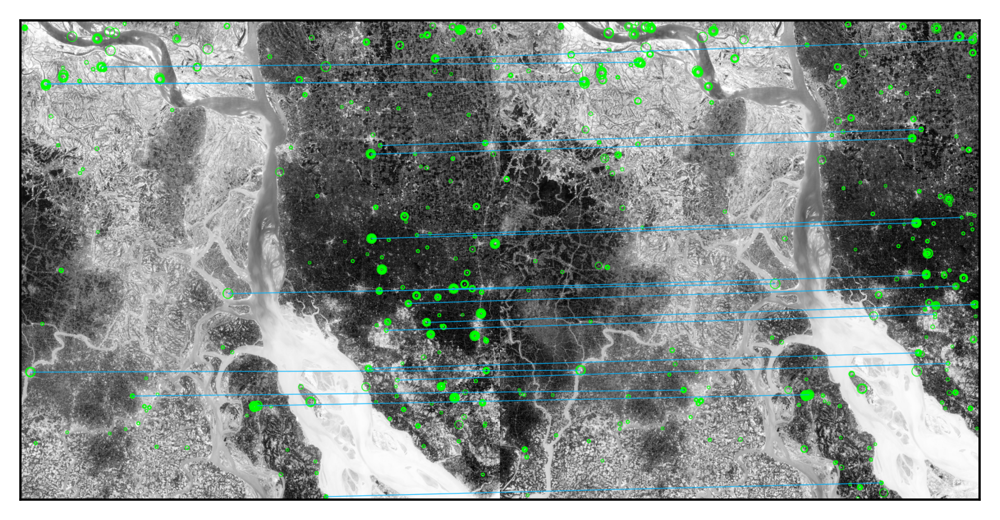

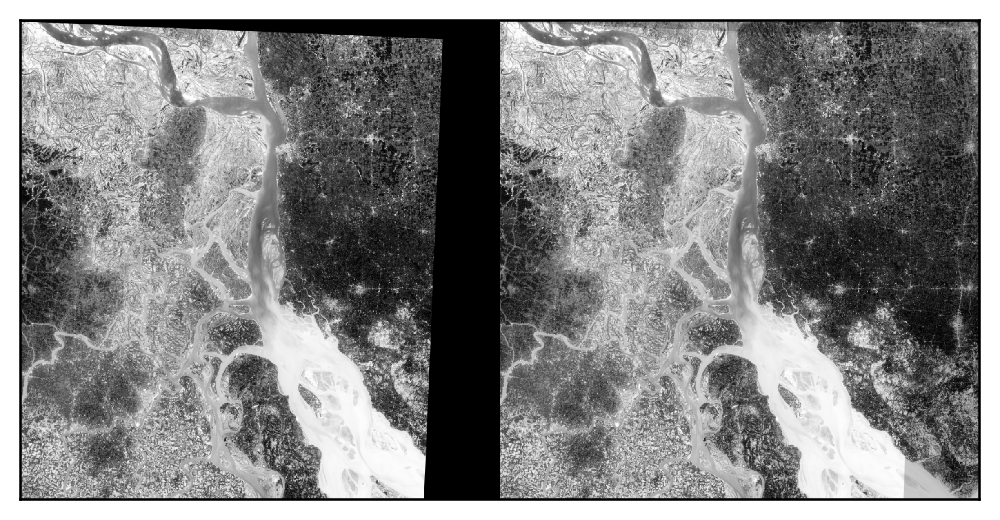

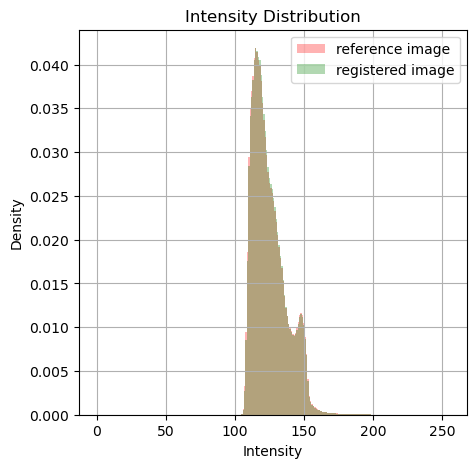

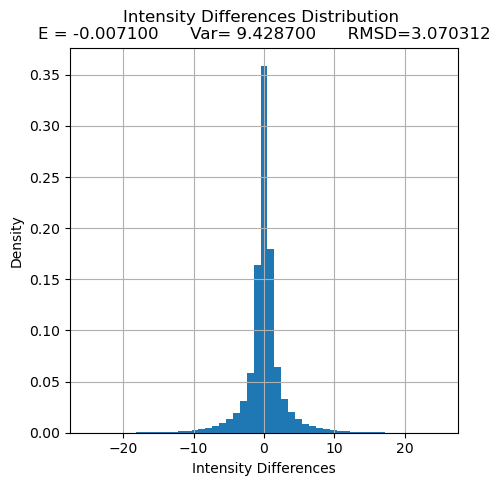

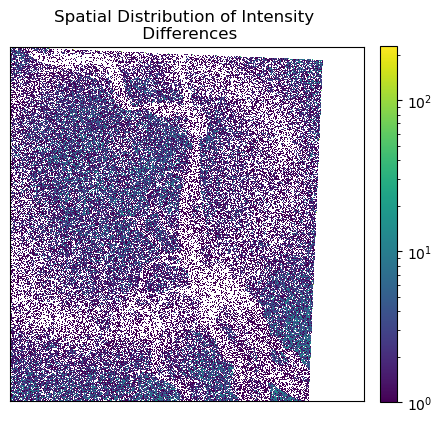

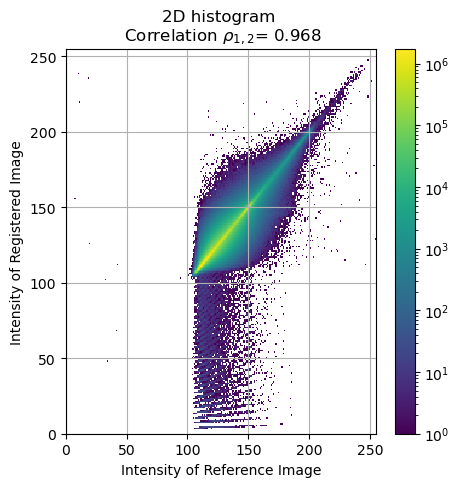

RMSD= 3.070312     Expect= -0.007100      Var = 9.428700    cc = 0.968424


In [4]:
ref = 'src\S2A_MSIL1C_20230312T042701_N0509_R133_T46QBL_20230312T062152.SAFE\GRANULE\L1C_T46QBL_A040313_20230312T043803\IMG_DATA\T46QBL_20230312T042701_B04.jp2'
reg = 'src\S2A_MSIL1C_20230312T042701_N0509_R133_T45QZF_20230312T062152.SAFE\GRANULE\L1C_T45QZF_A040313_20230312T043803\IMG_DATA\T45QZF_20230312T042701_B04.jp2'
tr  = 'mat\T_ORB_4546_pad0.npy'
find_registration(ref,reg,tr,vizualisation=True)
root_msd,exp,var,cc = evaluate_registration(ref,reg,tr,vizualisation=True)

print('RMSD= %f     Expect= %f      Var = %f    cc = %f'%(root_msd,exp,var,cc))

Registration and avaluation of padded images (30 pixels) Affine Transform

500 500
Transformation matrix:
[[ 9.98190040e-01 -4.09833665e-02 -1.31461880e+03]
 [ 4.11290167e-02  9.97771193e-01 -5.25845194e+01]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]


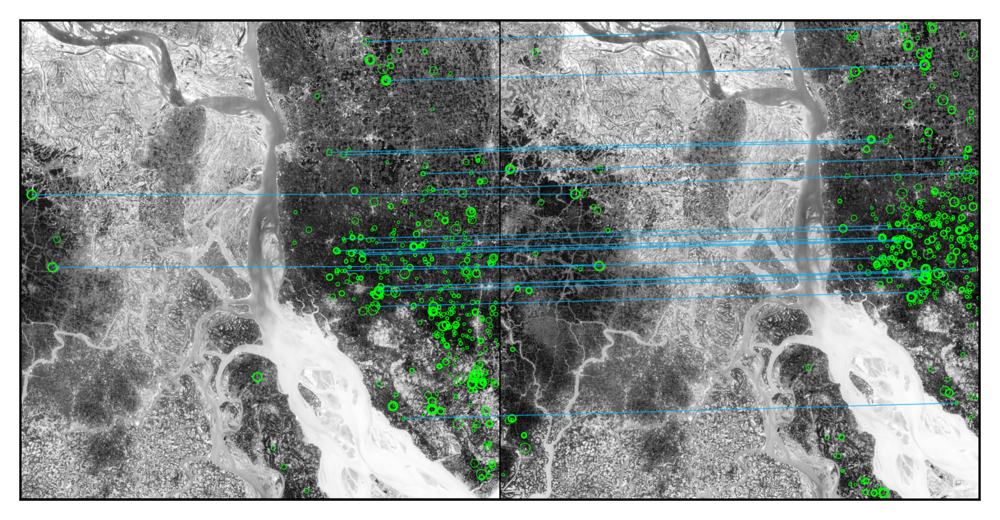

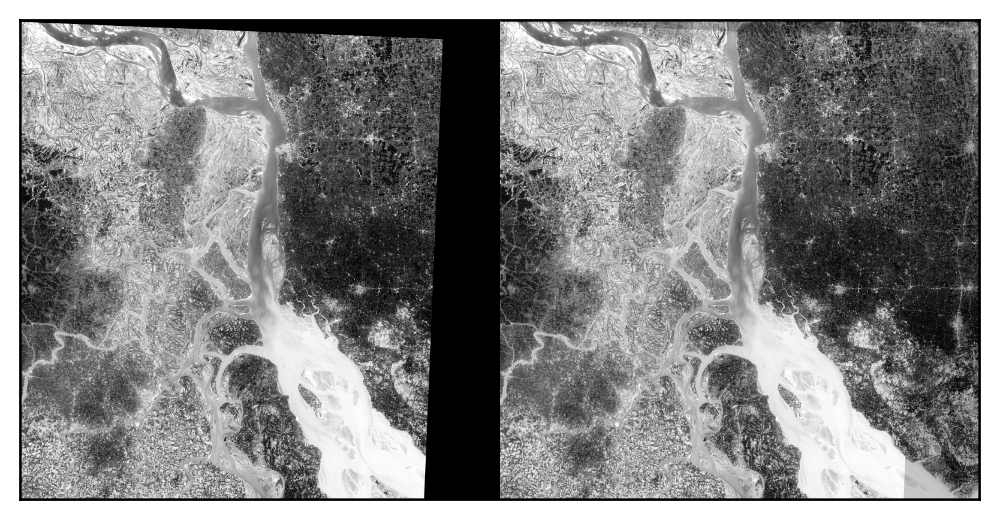

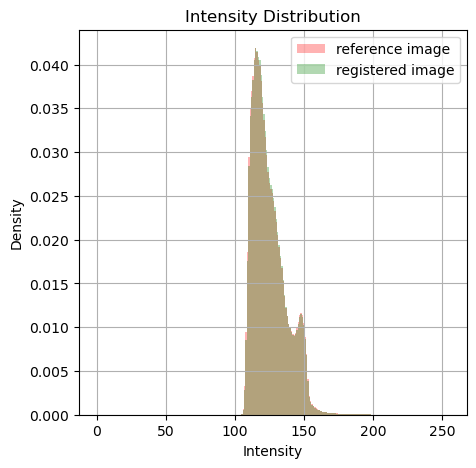

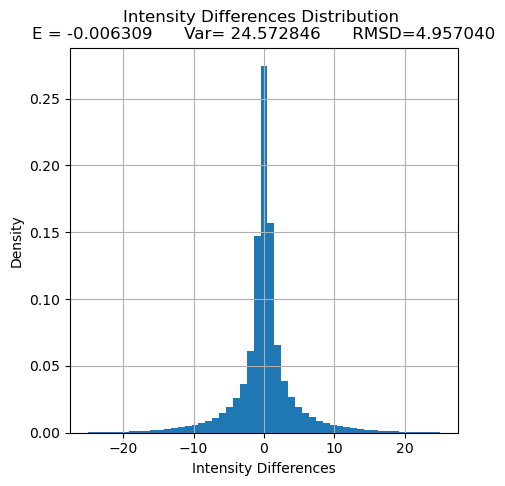

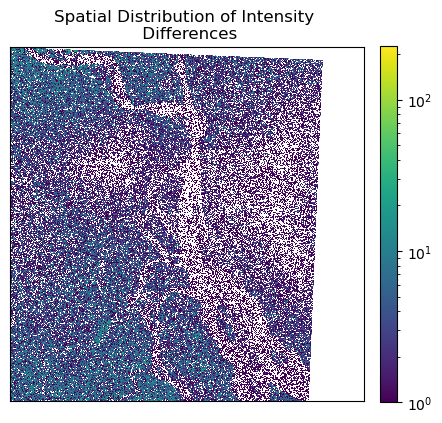

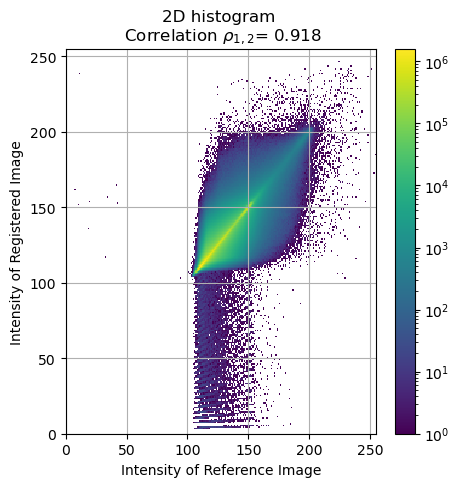

RMSD= 4.957040     Expect= -0.006309      Var = 24.572846    cc = 0.917654


In [7]:
ref = 'src\S2A_MSIL1C_20230312T042701_N0509_R133_T46QBL_20230312T062152.SAFE\GRANULE\L1C_T46QBL_A040313_20230312T043803\IMG_DATA\T46QBL_20230312T042701_B04.jp2'
reg = 'img\im2_45_pad30_False.jp2'
tr  = 'mat\T_ORB_4546_pad30.npy'
find_registration(ref,reg,tr,transform='affine',vizualisation=True)
root_msd,exp,var,cc = evaluate_registration(ref,reg,tr,vizualisation=True)

print('RMSD= %f     Expect= %f      Var = %f    cc = %f'%(root_msd,exp,var,cc))

Registration and evaluation of padde images (30 pixels)

500 500
Transformation matrix:
[[ 9.98975707e-01 -4.11216836e-02 -1.31703129e+03]
 [ 4.14916962e-02  9.98284866e-01 -5.57724509e+01]
 [ 6.36365296e-08 -1.38301078e-08  1.00000000e+00]]


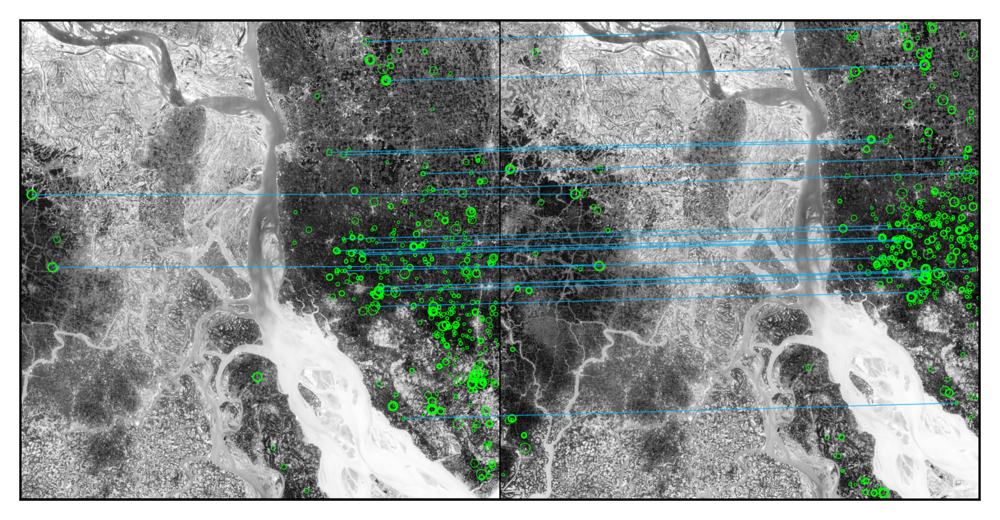

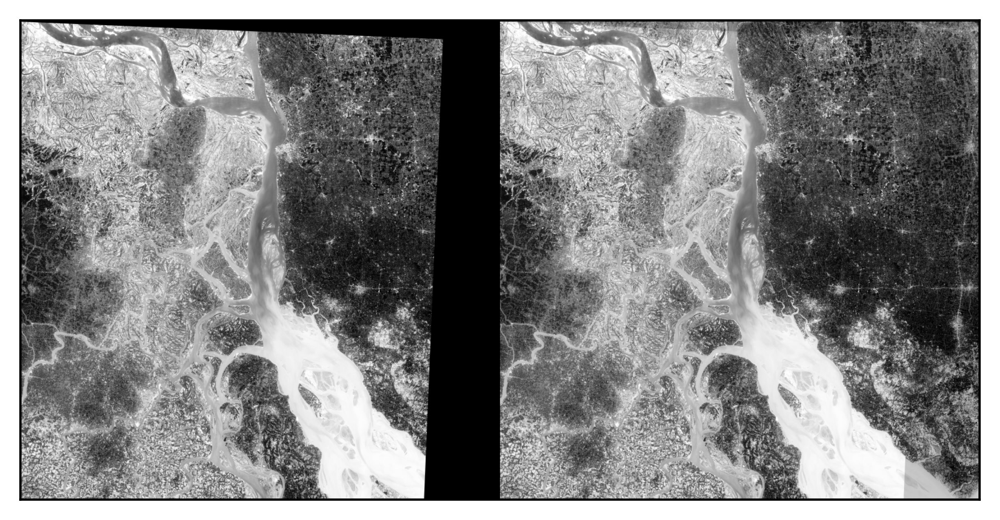

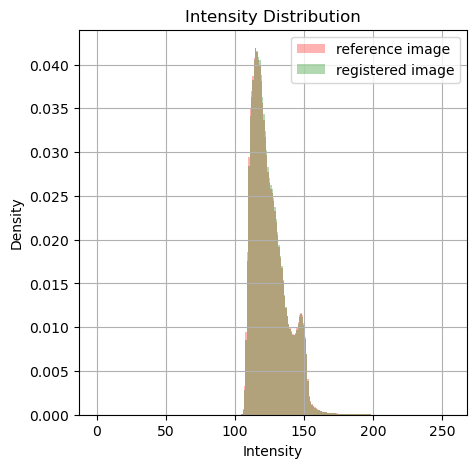

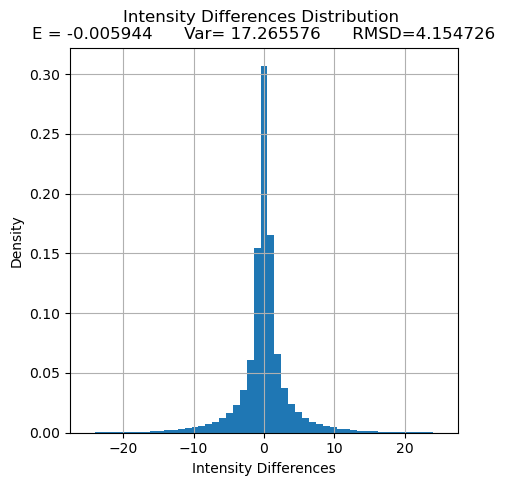

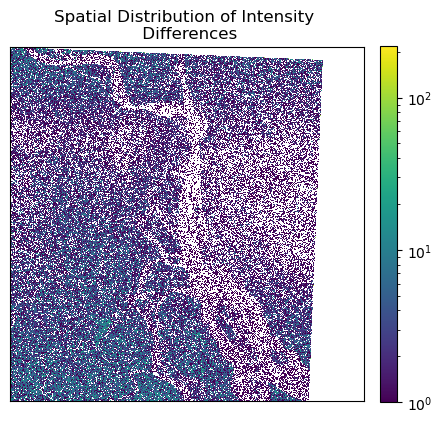

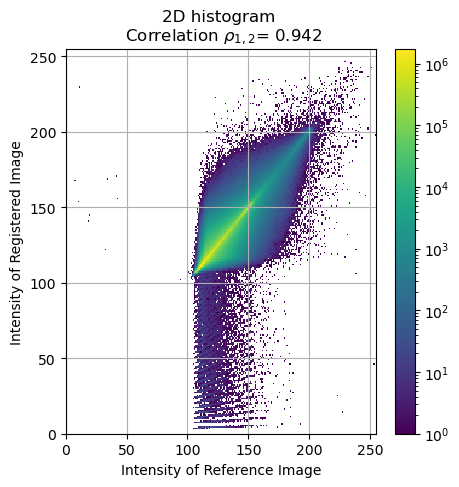

RMSD= 4.154726     Expect= -0.005944      Var = 17.265576    cc = 0.942153


In [6]:
ref = 'src\S2A_MSIL1C_20230312T042701_N0509_R133_T46QBL_20230312T062152.SAFE\GRANULE\L1C_T46QBL_A040313_20230312T043803\IMG_DATA\T46QBL_20230312T042701_B04.jp2'
reg = 'img\im2_45_pad30_False.jp2'
tr  = 'mat\T_ORB_4546_pad30.npy'
find_registration(ref,reg,tr,vizualisation=True)
root_msd,exp,var,cc = evaluate_registration(ref,reg,tr,vizualisation=True)

print('RMSD= %f     Expect= %f      Var = %f    cc = %f'%(root_msd,exp,var,cc))

Evaluation of Rasterio transform

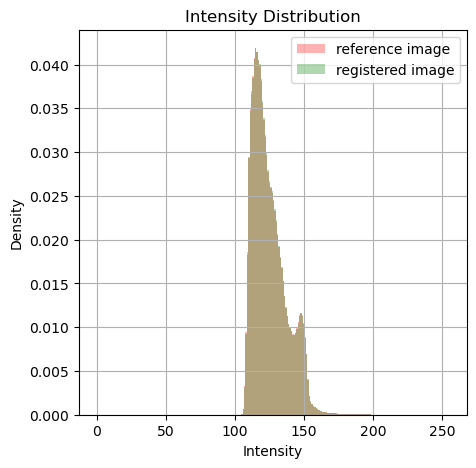

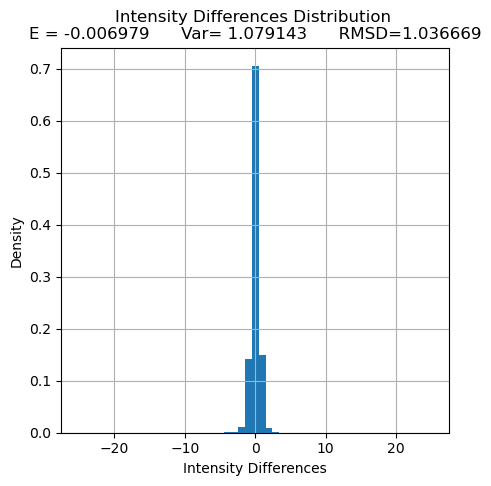

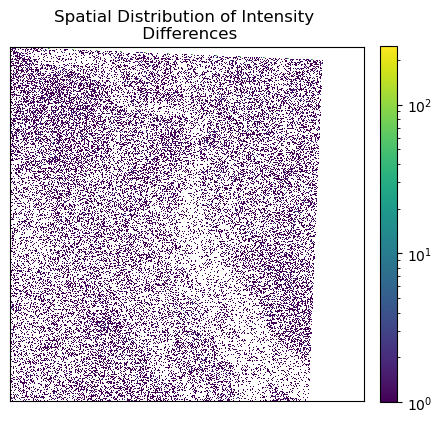

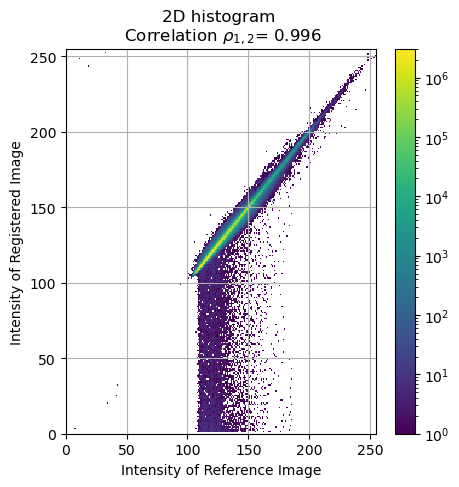

RMSD= 1.036669     Expect= -0.006979      Var = 1.079143    cc = 0.996407


In [8]:
ref = 'src\S2A_MSIL1C_20230312T042701_N0509_R133_T46QBL_20230312T062152.SAFE\GRANULE\L1C_T46QBL_A040313_20230312T043803\IMG_DATA\T46QBL_20230312T042701_B04.jp2'
reg = 'img\warp_pad30_True.jp2'
tr  = 'mat\identity.npy'
np.save(tr,np.identity(3))
root_msd,exp,var,cc = evaluate_registration(ref,reg,tr,vizualisation=True)

print('RMSD= %f     Expect= %f      Var = %f    cc = %f'%(root_msd,exp,var,cc))

Evaluation of our co-registration method using rasterio projection to EPSG32646

Transformation matrix:
[[ 1.00005392e+00 -1.29351248e-05 -2.87829387e+01]
 [ 1.03453711e-04  9.99930196e-01 -3.13948635e+01]
 [ 1.25182371e-08 -9.53860759e-09  1.00000000e+00]]


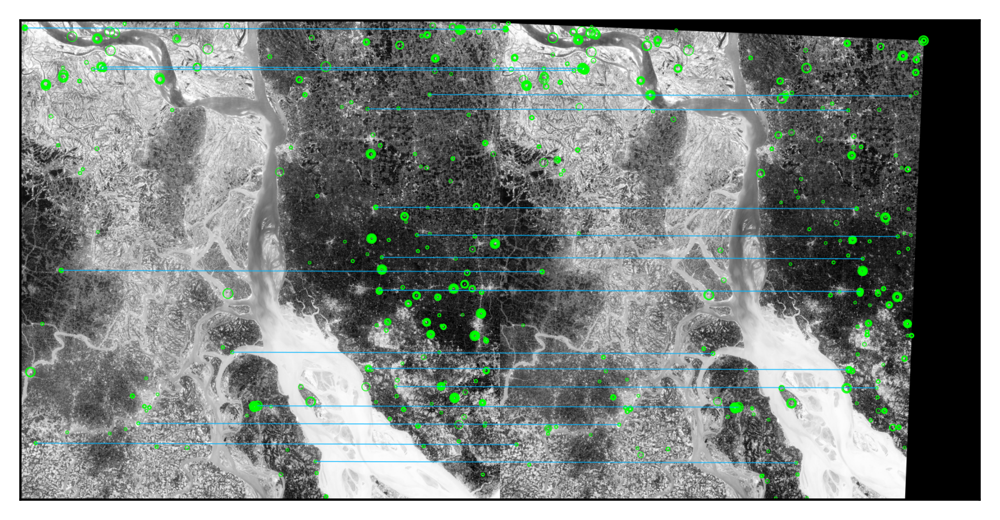

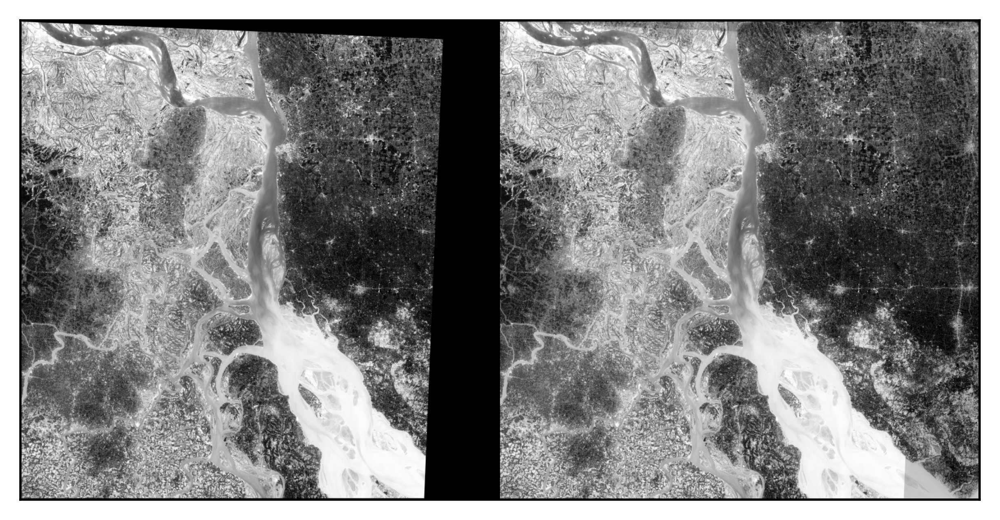

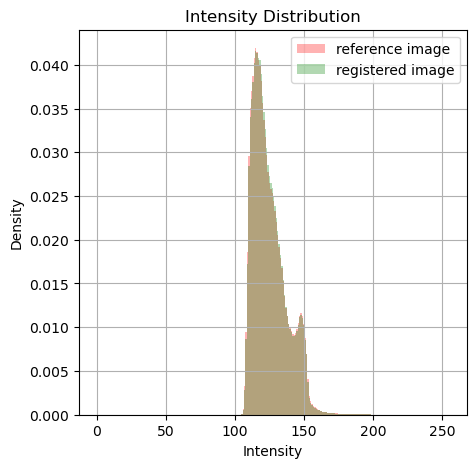

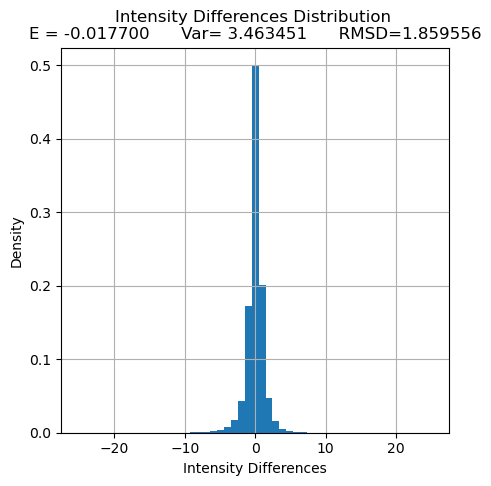

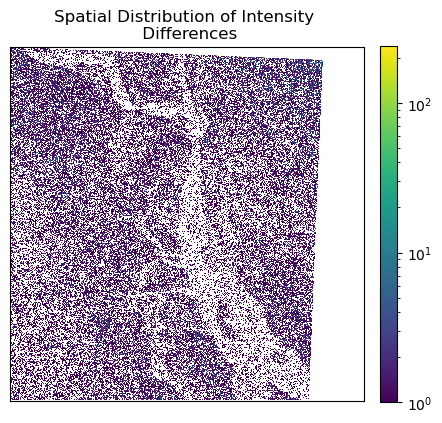

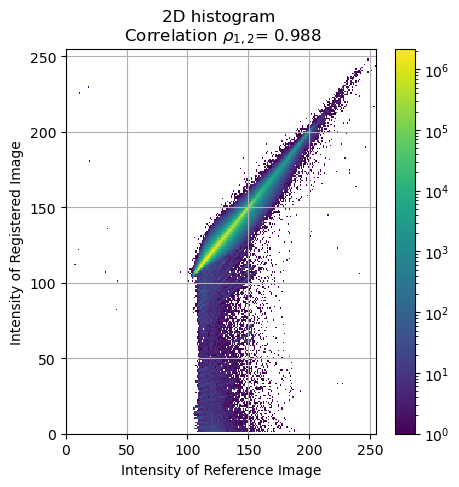

RMSD= 1.859556     Expect= -0.017700      Var = 3.463451    cc = 0.988415


In [9]:
ref = 'src\S2A_MSIL1C_20230312T042701_N0509_R133_T46QBL_20230312T062152.SAFE\GRANULE\L1C_T46QBL_A040313_20230312T043803\IMG_DATA\T46QBL_20230312T042701_B04.jp2'
reg = 'img\warp_pad30_False.jp2'
tr  = 'mat\T_ORB_4545_pad30.npy'
find_registration(ref,reg,tr,vizualisation=True)
root_msd,exp,var,cc = evaluate_registration(ref,reg,tr,vizualisation=True)

print('RMSD= %f     Expect= %f      Var = %f    cc = %f'%(root_msd,exp,var,cc))